## ALY6140 Capstone Project
### Data Mining on NYPD Shooting Incidents
***Group 1:*** *Silu Wang, Jiacheng Qiao*<br>
***Supervisor:*** *Zhi He*

### Introduction
Gun shooting has long been a social security issue in the US. Every year, a large number of victims were injured or
killed in New York City due to a shooting incident. In this regard, analyzing and learning from the historic incident data is meaningful
and helpful for both the police departments and the society as a whole. The dataset for this project is a collection of every shooting incident
that occurred in NYC going back to 2006 through May 2021, including information about the victim, the perpetrator, the location, and the time of occurrence.

This project tries to provide a descriptive summary on when and where shooting incidents frequently happened and a big picture of the perpetrators and the victims.
The goal of this project is to inform NYC citizens of shooting activities summary, including criminal hotspots and frequency, and help NYPD classify perpetrators' age groups based on the information in hand.

In [1]:
import class_utility as c
import eda_utility as u
import pandas as pd
import geopandas as gpd
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.neural_network import MLPClassifier

### Data Preprocessing
In the first part, we clean the dataset with several steps to prepare it for the EDA and modeling. Specific steps include:
* Drop useless features.
* Remove out of range values in class attribute and combine "45-64" and "65+" into one group "45+".
* Map date and time variables into month, year, weekday, and morning/afternoon/evening/night of a day.


In [2]:
df_ori = pd.read_csv('files/NYPD_Shooting_Incident_Data__Historic_.csv')
df = c.clean_dataset(df_ori)
df.head()

,OCCUR_DATE,OCCUR_TIME,BORO,STATISTICAL_MURDER_FLAG,PERP_AGE_GROUP,PERP_SEX,PERP_RACE,VIC_AGE_GROUP,VIC_SEX,VIC_RACE,Latitude,Longitude,month,year,weekday
0,2019-08-23,Evening,QUEENS,False,NaN,NaN,NaN,25-44,M,BLACK,40.697805,-73.808141,8,2019,Friday
1,2019-11-27,Afternoon,BRONX,False,<18,M,BLACK,25-44,F,BLACK,40.818700,-73.918571,11,2019,Wednesday
2,2019-02-02,Evening,MANHATTAN,False,18-24,M,WHITE HISPANIC,18-24,M,BLACK HISPANIC,40.791916,-73.945480,2,2019,Saturday
3,2019-10-24,Night,STATEN ISLAND,True,25-44,M,BLACK,25-44,F,BLACK,40.638064,-74.166108,10,2019,Thursday
4,2019-08-22,Afternoon,BRONX,False,25-44,M,BLACK HISPANIC,18-24,M,BLACK,40.854547,-73.913339,8,2019,Thursday


### EDA
With the cleaned dataset, we can conduct exploratory data analysis to gain insights on the nature of shooting incidents in New York City. Questions we tried to anser include:
1. **When** does shooting usually happen?
2. **Who** conducts shooting and who gets targeted?
3. **Where** are the hotspots where shootings frequently happen ?

### When
By plotting monthly incidents for each year, it's clear that more shooting incidents happened in summertime than other months.
Overall the frequency of shooting increased from spring to summer, decreased since September, and achieved the lowest time in February.

If we break down into days of the week, more shooting happened in Saturday and Sunday.
If we break down into time of a day, evening and midnight are the peak hours.

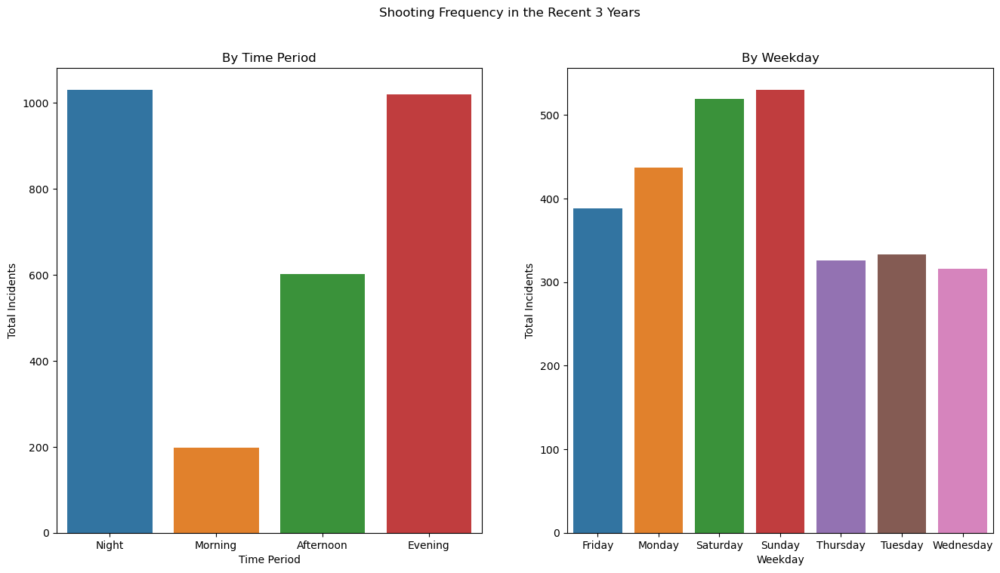

In [3]:
# EDA
# Exploring month frequency
u.month_plotting(df)

# Exploring time period and weekday frequency
u.time_weekday_plotting(df)

### Who

According to the age distribution by gender plots, for both victims and perpetrators, there are way more males than females.
Also, victims are mostly around 25-44 years old while perpetrators show a younger group with age around 18-24.

In [3]:
u.age_distribution(df)

### Where

From the 3 interactive maps below, we are able to explore the shooting hotspots around New York City.
In case of overplotting, I only drew the recent 5 years incidents on the hotspot map.

From the maps, we can find that there's a clear boundary in Manhattan, the 97 st, which split the island into two distinctive area.
The upper Manhattan is far more dangerous than the central and lower area, in terms of the nunmber of shooting incidents.
Also, from the choropleth map, we can find that Brooklyn saw the most shootings in the past decade.

In [4]:
nyc_location = [40.71, -74.00]

hotspot_map = u.hotspot_map(df, nyc_location)
hotspot_map

In [5]:
cluster_map = u.cluster_map(df, nyc_location)
cluster_map

In [5]:
# import borough data
city = gpd.read_file('files/Borough_Boundaries.geojson')

choropleth_map = u.choropleth_map(df, nyc_location, city)
choropleth_map


### Predictive Models
The other goal of our project is to help the police department predict the age group of perpetrators. We employed three
classification algorithm to build models, namely Decision Tree, Random Forest, and Multi-layer Perceptron.

Before training the models, some more feature engineering steps are necessary:
* **Handle Missing Values** <br>
By checking the missing value count of each feature, we found that over 8k records don't have information of perpetrators, including the age, gender and race.
This might be due to the failure to arrest the perpetrators. Since the perpetrator's age group is the class attribute we want to predict and is necessary for training, we just dropped the rows without this value.
* **Handle Categorical Data**<br>
Since all of our features are categorical and most machine learning models only work on numerical variables,
preprocessing the categorical variables is a necessary step in our project. We employed the most common one-hot encoding method
to create dummy variables for each level of the categorical features. After encoding, we have each column represent a category,
where 1 stands for that category and 0 stands for not that category.

**The main models steps includes:**

Main steps of mining on the age groups includes:
* **Split dataset into train and test sets (70/30)**<br>
When splitting, we used stratified splitting to make sure the distribution of classes remain the same in both train and test set.
* **Train initial models with simple common parameters**<br>
For the initial training, we set one simple parameter for each model to have a brief overview about how each classifier performs.
* **Use GridSearch to tune the hyperparameters**<br>
To find the optimal or near optimal models, we tuned the classifiers with several important hyperparameters.

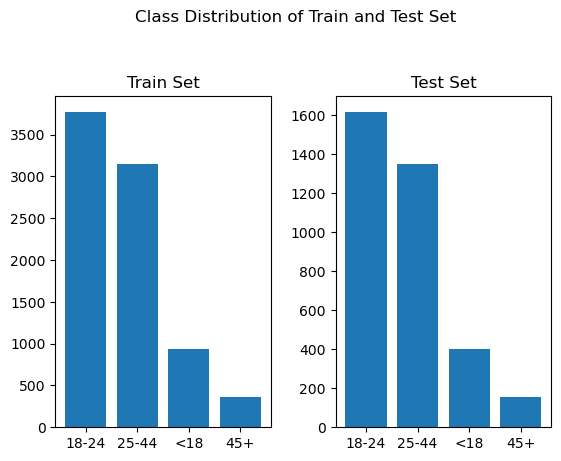

In [3]:
# Predictive models
# Feature engineering and train/test split
X_train, X_test, y_train, y_test = c.encode_split_dataset(df, test_size=0.3, rand_state=42)

# Distribution of class attribute in test sets
c.class_distribution(y_train, y_test)


Overall, the initial results show weak classifications with an average accuracy around 0.5.
The confusion matrix indicates that the models can hardly tell “45+” and “<18” groups from the other two groups.
There might be several reasons. First, although we combined “45-64” and “65+” into the bigger group “45+”, “<18” and “45+” are still minorities as compared to the other two groups.
The poor performance might be due to the lack of data to train models that capture minorities well. To tackle this problem, we tried undersampling the dominant groups or oversampling the minority groups to balance the class distribution, but the performance got even worse with fewer data in each group.

Another reason might be due to the choice of hyperparameters. With one simple hyperparameter, it’s hard to achieve the optimal performance at the initial training phase.
Therefore, we used GridSearchCV to experiment with different combinations of hyperparameters to search for the optimal ones.
Due to the limitation of computational power, only a few possibilities were tried.

In [23]:
# Train, test, and evaluate models
clfs = {'RandomForestClassifier': RandomForestClassifier(max_features=5),
       'DecisionTreeClassifier': DecisionTreeClassifier(max_depth=5),
       'MLPClassifier': MLPClassifier(max_iter=1000)}

c.initial_train_evaluate(df, clfs)

Initial model parameters: RandomForestClassifier(max_features=5)

Accuracy of RandomForestClassifier Tuned model: 0.5377626348665531

Classification Report of RandomForestClassifier Initial model:
              precision    recall  f1-score   support

       18-24       0.54      0.71      0.61      1617
       25-44       0.56      0.50      0.53      1350
         45+       0.60      0.18      0.27       154
         <18       0.32      0.11      0.17       401

    accuracy                           0.54      3522
   macro avg       0.50      0.37      0.40      3522
weighted avg       0.52      0.54      0.51      3522

Confusion Matrix of RandomForestClassifier Initial model:
[[1141  389    3   84]
 [ 642  680   15   13]
 [  46   80   27    1]
 [ 289   66    0   46]]
---------------------------------------------------------------------------------------------------------------
Initial model parameters: DecisionTreeClassifier(max_depth=5)

Accuracy of DecisionTreeClassifier Tuned m

/Users/siluwang/opt/anaconda3/envs/py38/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1245: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/siluwang/opt/anaconda3/envs/py38/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1245: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/siluwang/opt/anaconda3/envs/py38/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1245: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

Initial model parameters: MLPClassifier(max_iter=1000)

Accuracy of MLPClassifier Tuned model: 0.4804088586030664

Classification Report of MLPClassifier Initial model:
              precision    recall  f1-score   support

       18-24       0.59      0.44      0.50      1617
       25-44       0.50      0.61      0.55      1350
         45+       0.19      0.51      0.28       154
         <18       0.32      0.22      0.26       401

    accuracy                           0.48      3522
   macro avg       0.40      0.44      0.40      3522
weighted avg       0.51      0.48      0.48      3522

Confusion Matrix of MLPClassifier Initial model:
[[704 655 122 136]
 [309 821 170  50]
 [ 19  53  78   4]
 [155 122  35  89]]
---------------------------------------------------------------------------------------------------------------


In general, the performance of tuned models is acceptable, with an overall accuracy of around 54%.
All the three classifiers perform better after adjusting, with the accuracy of the decision tree model and random forest model increasing slightly by 1% while that of the MLP model surging by 6%.

However, the metrics for each class changes differently. The random forest model saw a general increase for all scores among each class, while for the other two classifiers, there is a trade-off between one class and another.
Another great improvement is that they classify minority classes better. The MLP model performs the best among the three classifiers in terms of predicting minority groups “45+” (f1-score = 0.35) and “<18” (f1-score = 0.25).

In [87]:
# Tune hyperparameters, train new models, and evaluate
tuning_params = {
        'RandomForestClassifier': [RandomForestClassifier(), 
                                   {'max_features': [1, 3, 5],
                                    'n_estimators': [20, 200]}],
        'DecisionTreeClassifier': [DecisionTreeClassifier(), 
                                   {'max_depth': [1, 3, 5],
                                    'max_leaf_nodes': [5, 50]}],
        'MLPClassifier': [MLPClassifier(), 
                          {'alpha': [1, 2],
                           'max_iter': [1000, 5000]}]
}

c.tune_models(df, tuning_params)

Best parameters of RandomForestClassifier found:
 {'max_features': 3, 'n_estimators': 200}

Tuned model parameters: RandomForestClassifier(max_features=3, n_estimators=200)

Accuracy of RandomForestClassifier Tuned model: 0.5508233957978421

Classification Report of RandomForestClassifier Tuned model:
              precision    recall  f1-score   support

       18-24       0.55      0.72      0.62      1617
       25-44       0.58      0.51      0.54      1350
         45+       0.62      0.20      0.30       154
         <18       0.34      0.13      0.19       401

    accuracy                           0.55      3522
   macro avg       0.52      0.39      0.42      3522
weighted avg       0.54      0.55      0.53      3522

Confusion Matrix of RandomForestClassifier Tuned model:
[[1165  363    3   86]
 [ 629  691   16   14]
 [  48   74   31    1]
 [ 283   65    0   53]]
---------------------------------------------------------------------------------------------------------------
B

/Users/siluwang/opt/anaconda3/envs/py38/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1245: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/siluwang/opt/anaconda3/envs/py38/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1245: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/siluwang/opt/anaconda3/envs/py38/lib/python3.8/site-packages/sklearn/metrics/_classification.py:1245: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_

Best parameters of MLPClassifier found:
 {'alpha': 2, 'max_iter': 1000}

Tuned model parameters: MLPClassifier(alpha=2, max_iter=1000)

Accuracy of MLPClassifier Tuned model: 0.5391822827938672

Classification Report of MLPClassifier Tuned model:
              precision    recall  f1-score   support

       18-24       0.57      0.60      0.58      1617
       25-44       0.56      0.60      0.58      1350
         45+       0.48      0.28      0.35       154
         <18       0.30      0.21      0.25       401

    accuracy                           0.54      3522
   macro avg       0.48      0.42      0.44      3522
weighted avg       0.53      0.54      0.53      3522

Confusion Matrix of MLPClassifier Tuned model:
[[964 496  14 143]
 [463 806  28  53]
 [ 36  72  43   3]
 [233  77   5  86]]
---------------------------------------------------------------------------------------------------------------


## Interpretation and Conclusion
Through exploratory data analysis, we found that summer saw the most shooting incidents over a year and crimes mostly happened on weekends and at night.
One thing surprising is that men make up the majority of both criminals and victims. According to the maps, upper Manhattan and Brooklyn are the most dangerous areas in NYC in general.

Regarding predictive models, random forest performs the best among all three algorithms, with an accuracy of 0.55.
Since the random forest model is an ensemble learning method that combines a set of decision tree models to build a stronger learner,
it can be concluded that ensemble algorithms perform better than a single algorithm on our dataset.
Also, the multi-layer perceptron classifier shows a more balanced performance for each class when learning from an imbalanced dataset.